# Experiment: 3D LUT Style Translation with a StarGAN
With the adaptation of StarGAN we hope to further increase stability and quality of our generated 3D LUTs as well as getting a model that can translate digital images to a variety of different analog films at once.

StarGAN was introduced as another adaptation of GANs that can perform image-to-image translation for multiple domains using only a single model. It uses one discriminator *D* and one generator *G*. As in GAN  the *D* is trained to distinguish between real and fake images. In addition to that in StarGAN *D* is also trained to classify the real images to their corresponding domain. 
The generator *G* takes an input image and the newly introduced target domain label. It attempts to "generate images indistinguishable from real images and classifiable as target domain by *D*" [Source](http://arxiv.org/abs/1711.09020). Cycle-consistency loss is integrated into StarGAN as *G* is trained to reconstruct the original image of the original domain based on the generated fake image. To help with generalization and reduce noise in our generated 3D LUTs, we do also integrate identity mapping loss by translating images to their original domain. 

Soure StarGAN: http://arxiv.org/abs/1711.09020 \
Source GAN: https://arxiv.org/abs/1406.2661

As the training was far more stable than with CycleGAN, we decided to use the ResNet
model that we introduced in 2.1.1 and the discriminator that we introduced in the GAN notebook. 
We adapted both the generator and the discriminator to incorporate the domain label. We
train our model with 250 images each of Kodak Gold, Cinestill 800T, Kodak Ektar and
Sony digital images. We downsampled the images to a resolution of 128 x 128 pixels.
We use a batch size of 128, a learning rate of 0.0001 and weighted the cycle-consistency
loss with a factor of 4 and the identity mapping loss with a factor of 0.25. We train for
2000 episodes.

## Imports

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import numpy as np
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
from IPython.display import display
import os
import matplotlib.pyplot as plt
from pytorch_msssim import ssim, ms_ssim # https://pypi.org/project/pytorch-msssim/
import torchvision.transforms.functional as TF
import torchvision.utils as vutils
from torchinfo import summary
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torchvision.utils import save_image

C:\Users\Niko\anaconda3\envs\FilmGAN_01\Lib\site-packages\albumentations\__init__.py:24: UserWarning: A new version of Albumentations is available: '2.0.4' (you have '2.0.0'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


## Hyperparameters

In [2]:
batch_size = 128
learning_rate = 1e-4
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
num_epochs = 2000

num_workers = 4
lambda_cycle = 4
lambda_identity = 0.25

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of feature maps in discriminator
ndf = 64

# Checkpoint file paths
experiment = "stargan_v8_128"

name_d1 = "Kodak_Gold"
name_d2 = "Cinestill"
name_d3 = "Sony"
name_d4 = "Kodak_Ektar"

filepath_d1 = "../../analogdb_images/kodak_gold"
filepath_d2 = "../../analogdb_images/cinestill_800t"
filepath_d3 = "../../sony_images"
filepath_d4 = "../../analogdb_images/kodak_ektar"

We performed another training run where we weighted the cycle-consistency loss with a factor of 2 instead of 4 and the identity mapping loss with a factor of 0.1 instead of 0.25 in the expectation to get greater differences between edited images. \
Through greater variation in our training data, the models performance on unseen validation images is also improved.

In [205]:
batch_size = 128
learning_rate = 1e-4
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
num_epochs = 2000

num_workers = 4
lambda_cycle = 2
lambda_identity = 0.1

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of feature maps in discriminator
ndf = 64

# Checkpoint file paths
experiment = "stargan_v9_128"

name_d1 = "Kodak_Gold"
name_d2 = "Cinestill"
name_d3 = "Sony"
name_d4 = "Kodak_Portra"

filepath_d1 = "../../analogdb_images/kodak_gold"
filepath_d2 = "../../analogdb_images/cinestill_800t"
filepath_d3 = "../../sony_images/wedding/random"
filepath_d4 = "../../analogdb_images/kodak_portra_400"

## Dataset

In [4]:
class MultiDomainImageDataset(Dataset):
    def __init__(self, d1, d2, d3, d4, transform=None):
        self.data = []
        self.labels = []
        self.transform = transform

        # Assign domain labels (one-hot encoding)
        for img in d1:
            self.data.append(img)
            self.labels.append([1, 0, 0, 0])  # Domain 1

        for img in d2:
            self.data.append(img)
            self.labels.append([0, 1, 0, 0])  # Domain 2

        for img in d3:
            self.data.append(img)
            self.labels.append([0, 0, 1, 0])  # Domain 3

        for img in d4:
            self.data.append(img)
            self.labels.append([0, 0, 0, 1])  # Domain 4

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx]
        label = torch.tensor(self.labels[idx], dtype=torch.float32)  # One-hot encoded label

        if self.transform:
            image = self.transform(image)

        return image, label

In [5]:
transform64 = transforms.Compose([
    transforms.Resize(128),
    transforms.CenterCrop((128, 128)),
    transforms.ToTensor(), 
    #transforms.RandomRotation(degrees=15),
    #transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),

    #transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

In [ ]:
def load_images_from_directory(directory_path, num_images=100, offset=0):
    images = []
    files = os.listdir(directory_path)
    # Ensure only images are processed
    image_files = [f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    for i, image_file in enumerate(image_files[offset:offset+num_images]):
        image_path = os.path.join(directory_path, image_file)
        img = Image.open(image_path).convert('RGB')  # Convert to RGB in case of grayscale
        img = transform64(img)  # Apply the transformations
        images.append(img)
        
    images_tensor = torch.stack(images)
    images_tensor = images_tensor.permute(0, 2, 3, 1)
    return images_tensor

d1_images = load_images_from_directory(filepath_d1, num_images=250)
d2_images = load_images_from_directory(filepath_d2, num_images=250)
d3_images = load_images_from_directory(filepath_d3, num_images=250)
d4_images = load_images_from_directory(filepath_d4, num_images=250)
# Verify the shape of the tensors
print(d1_images.shape)  # Should be [num_images, 64, 64, 3]
print(d2_images.shape)  # Should be [num_images, 64, 64, 3]
print(d3_images.shape)  # Should be [num_images, 64, 64, 3]

In [7]:
transform = transforms.Compose([transforms.ToTensor(), transforms.RandomHorizontalFlip(p=0.5)])

In [8]:
transformFlip = A.Compose(
    [
        A.Resize(width=64, height=64),
        A.HorizontalFlip(p=0.5),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5], max_pixel_value=255),
        ToTensorV2(),
    ],
    additional_targets={"image0": "image"},
) # Source: https://colab.research.google.com/drive/1BuI-9P1-ku00Nc1tPbBhoeL006-3tNUS?usp=sharing#scrollTo=LWqoRijtmm6n

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [10]:
d1_images_np = d1_images.numpy()
d2_images_np = d2_images.numpy()
d3_images_np = d3_images.numpy()
d4_images_np = d4_images.numpy()

dataset = MultiDomainImageDataset(d1_images_np, d2_images_np, d3_images_np, d4_images_np, transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

C:\Users\Niko\AppData\Local\Temp\ipykernel_188728\3647141795.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  d1_tensor = torch.tensor(d1_images[:64])


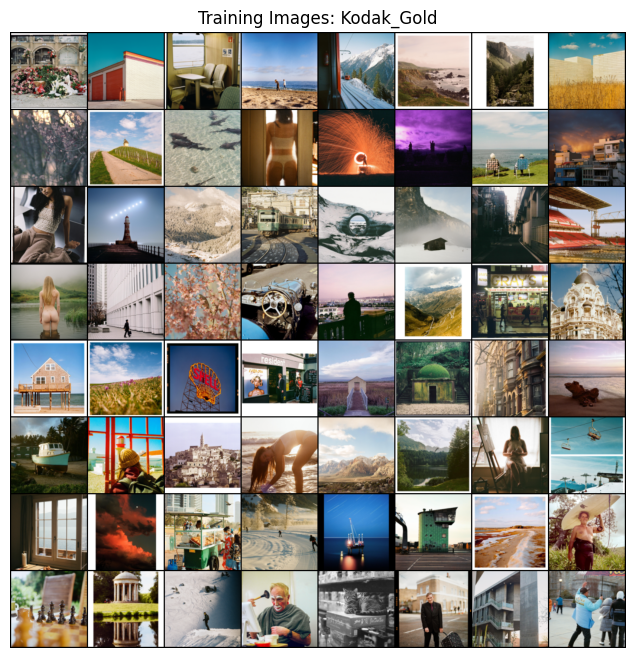

In [11]:
# Plot some training images
d1_tensor = torch.tensor(d1_images[:64])
d1_tensor = d1_tensor.permute(0,3,1,2)

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Training Images: {name_d1}")
plt.imshow(np.transpose(vutils.make_grid(d1_tensor, padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

C:\Users\Niko\AppData\Local\Temp\ipykernel_188728\3711274338.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  d2_tensor = torch.tensor(d2_images[:64])


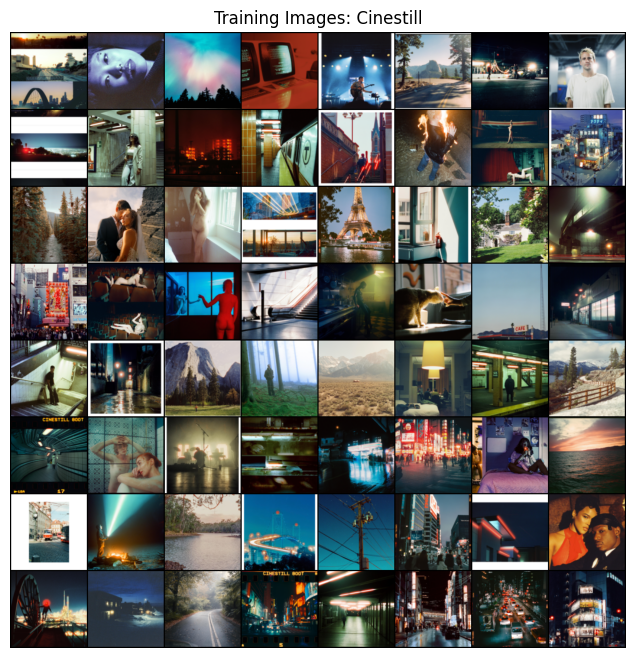

In [12]:
d2_tensor = torch.tensor(d2_images[:64])
d2_tensor = d2_tensor.permute(0,3,1,2)

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Training Images: {name_d2}")
plt.imshow(np.transpose(vutils.make_grid(d2_tensor, padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

C:\Users\Niko\AppData\Local\Temp\ipykernel_188728\1106963375.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  d3_tensor = torch.tensor(d3_images[:64])


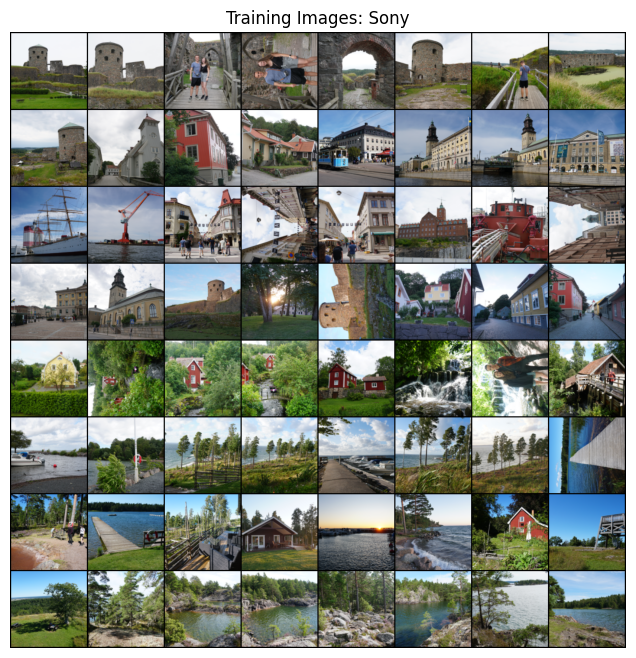

In [13]:
d3_tensor = torch.tensor(d3_images[:64])
d3_tensor = d3_tensor.permute(0,3,1,2)

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Training Images: {name_d3}")
plt.imshow(np.transpose(vutils.make_grid(d3_tensor, padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

C:\Users\Niko\AppData\Local\Temp\ipykernel_188728\973952875.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  d4_tensor = torch.tensor(d4_images[:64])


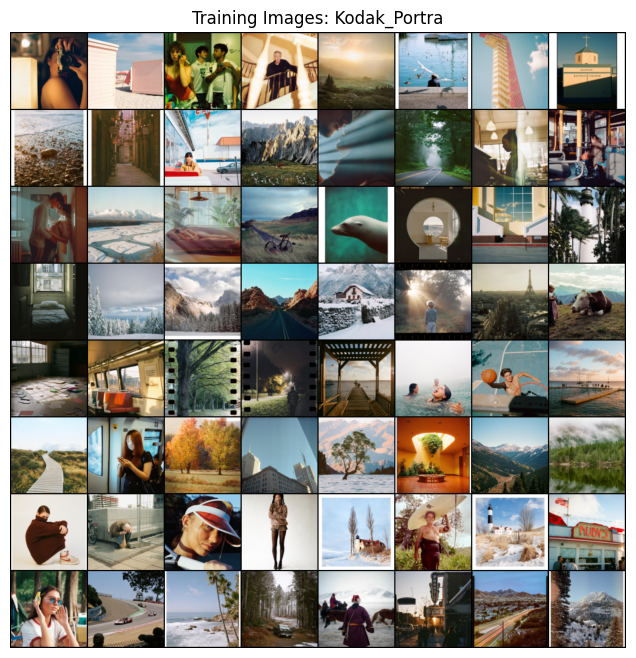

In [14]:
d4_tensor = torch.tensor(d4_images[:64])
d4_tensor = d4_tensor.permute(0,3,1,2)

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Training Images: {name_d4}")
plt.imshow(np.transpose(vutils.make_grid(d4_tensor, padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Models

From the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02. The weights_init function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.

https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [15]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator
We use our ResNet based Generator once again:

Instead of the initial 7x7 convolutional layer, we use a 3x3 filter with a padding of one in the initial convolutional layer that keeps the initial resolution, in this case at 256 x 256. As another measure to adapt the model to lower image resolutions, we use just three residual blocks in comparison to four in the original implementation. The residual blocks are identical to the ResNet implementation with a filter size of 3x3. Just as mentioned in the paper, "when the shortcuts go across feature maps of two sizes, they are performed with a stride of 2". In general, convolutional layers are followed by batch normalization and a ReLU activation function as in the original implementation. After the residual blocks, global average pooling is performed, also following the original implementation. Where the original implementation ends with a 1000-way fully connected layer with a softmax activation function for the task of classifying the 1000 classes in the ImageNet 2012 classification dataset, our model is adopted to generate 3D LUTs. The global average pooling layer is followed by a fully connected layer with 512 dimensions followed by ReLU activation and another fully connected layer that expands the output to the required dimensions for the 3D LUT, which is: LUT_size^3 * channels. The model can be initialized with varying LUT sizes; for an 8 bit LUT the last fully connected layer has 8 * 8 * 8 * 3 = 1536 dimensions.

Source: https://arxiv.org/pdf/1512.03385


In [16]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        residual = x
        out = F.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += self.shortcut(residual)
        return F.relu(out)

In [17]:
class LUTGenerator(nn.Module):
    def __init__(self, lut_size=8, label_dim=3, input_channels=3):
        super(LUTGenerator, self).__init__()
        self.lut_size = lut_size
        
        # Initial convolution
        self.initial_conv = nn.Sequential(
            nn.Conv2d(input_channels, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU()
        )
        
        # ResNet feature extraction
        self.layer1 = self._make_layer(32, 64, stride=2)
        self.layer2 = self._make_layer(64, 128, stride=2)
        #self.layer3 = self._make_layer(128, 256, stride=2)
        
        # Global average pooling
        self.global_pool = nn.AdaptiveAvgPool2d(1)

        # Fully connected layer for label conditioning
        self.label_fc = nn.Sequential(
            nn.Linear(label_dim, 32),  # Process the label into 32-dim feature
            nn.ReLU(),
            nn.Linear(32, 128)  # Match feature vector size
        )
        
        self.lut_generator = nn.Sequential(
            nn.Linear(128 + 128, 256),
            nn.ReLU(),
            nn.Linear(256, lut_size * lut_size * lut_size * 3)
        )

    def _make_layer(self, in_channels, out_channels, stride):
        return ResidualBlock(in_channels, out_channels, stride)
        
    def _trilinear_interpolation(self,luts, images):
        # Scale images to be between -1 and 1
        img = (images - 0.5) * 2.0  # Shape: [4, 3, 256, 256]
        
        # Add a singleton dimension to represent "channel" for LUT interpolation
        img = img.permute(0, 2, 3, 1).unsqueeze(1)  # Shape: [4, 1, 256, 256, 3]

        # Ensure LUT is in the correct format
        LUT = luts.permute(0, 4, 1, 2, 3)  # Shape: [4, 3, 8, 8, 8]
        
        # Perform grid sampling for each channel
        result = F.grid_sample(LUT, img, mode='bilinear', padding_mode='border', align_corners=True)  # [4, 3, 1, 256, 256]
    
        # Remove the singleton dimension and permute to the correct format
        result = result.squeeze(2)  # Remove the extra "depth" dimension: [4, 3, 256, 256]
    
        return result

    def _simple_approach(self, luts, images):
        lut = luts.view(luts.shape[0], luts.shape[2], luts.shape[2], luts.shape[2], 3)
        image_normalized = (images * luts.shape[2]-1).long()
        image_normalized = torch.clamp(image_normalized, 0, luts.shape[2]-1)
            
        r = image_normalized[:, 0, :, :]
        g = image_normalized[:, 1, :, :]
        b = image_normalized[:, 2, :, :]
            
        transformed = lut[torch.arange(luts.shape[0]).unsqueeze(-1).unsqueeze(-1), r, g, b]
        transformed = transformed.permute(0, 3, 1, 2)

        return transformed


    def forward(self, x, label):
        x_orig = x
        batch_size = x.size(0)
        x_orig = x  # Store original input
        x = self.initial_conv(x)
        x = self.layer1(x)
        x = self.layer2(x)
        #x = self.layer3(x)

        # Global pooling and feature compression
        features = self.global_pool(x).view(x.size(0), -1)

        # Label and combined features
        label_features = self.label_fc(label)
        combined_features = torch.cat([features, label_features], dim=1)

        lut = self.lut_generator(combined_features)
        lut = lut.view(-1, self.lut_size, self.lut_size, self.lut_size, 3)
        lut = torch.sigmoid(lut)

        transformed = self._trilinear_interpolation(lut, x_orig)
        return transformed, lut

In [18]:
sample_input = torch.rand(4, 3, 128, 128).to(device)
LUTGeneratorCNN=LUTGenerator(lut_size=9).to(device)
# Initialize weights
#weights_init(LUTGeneratorCNN)
label1 = [1,0,0]
label_tensor = torch.tensor(label1, dtype=torch.float32).repeat(4, 1).to(device)

transformed, lut = LUTGeneratorCNN(sample_input, label_tensor)
print(lut.shape)
print(transformed.shape)

torch.Size([4, 9, 9, 9, 3])
torch.Size([4, 3, 128, 128])


In [19]:
summary(LUTGeneratorCNN)

Layer (type:depth-idx)                   Param #
LUTGenerator                             --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       896
│    └─BatchNorm2d: 2-2                  64
│    └─ReLU: 2-3                         --
├─ResidualBlock: 1-2                     --
│    └─Conv2d: 2-4                       18,496
│    └─BatchNorm2d: 2-5                  128
│    └─Conv2d: 2-6                       36,928
│    └─BatchNorm2d: 2-7                  128
│    └─Sequential: 2-8                   --
│    │    └─Conv2d: 3-1                  2,112
│    │    └─BatchNorm2d: 3-2             128
├─ResidualBlock: 1-3                     --
│    └─Conv2d: 2-9                       73,856
│    └─BatchNorm2d: 2-10                 256
│    └─Conv2d: 2-11                      147,584
│    └─BatchNorm2d: 2-12                 256
│    └─Sequential: 2-13                  --
│    │    └─Conv2d: 3-3                  8,320
│    │    └─BatchNorm2d: 3-4             2

## Discriminator

We adapted the previously introduced Discriminator to classify images based on the domains as well.

In [20]:
class Discriminator(nn.Module):
    def __init__(self, nc=3, ndf=64, num_domains=3):
        super(Discriminator, self).__init__()
        self.num_domains = num_domains  # Number of domains to classify

        # Shared feature extractor
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True)
        )

        # Adversarial classification head (Real/Fake)
        self.adv_head = nn.Sequential(
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False)
        )

        # Domain classification head (Multi-class classification)
        self.cls_head = nn.Sequential(
            nn.Conv2d(ndf * 8, num_domains, 4, 1, 0, bias=False)
        )

    def forward(self, x):
        features = self.main(x)

        # Real/Fake classification output (scalar value per image)
        adv_output = self.adv_head(features).view(x.size(0), -1)  # Shape: [batch_size, 1]

        # Domain classification output (num_domains classes per image)
        cls_output = self.cls_head(features).view(x.size(0), -1)  # Shape: [batch_size, num_domains]

        return adv_output, cls_output

In [21]:
test_disc = Discriminator()
summary(test_disc)

Layer (type:depth-idx)                   Param #
Discriminator                            --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       3,072
│    └─LeakyReLU: 2-2                    --
│    └─Conv2d: 2-3                       131,072
│    └─BatchNorm2d: 2-4                  256
│    └─LeakyReLU: 2-5                    --
│    └─Conv2d: 2-6                       524,288
│    └─BatchNorm2d: 2-7                  512
│    └─LeakyReLU: 2-8                    --
│    └─Conv2d: 2-9                       2,097,152
│    └─BatchNorm2d: 2-10                 1,024
│    └─LeakyReLU: 2-11                   --
├─Sequential: 1-2                        --
│    └─Conv2d: 2-12                      8,192
├─Sequential: 1-3                        --
│    └─Conv2d: 2-13                      24,576
Total params: 2,790,144
Trainable params: 2,790,144
Non-trainable params: 0

In [22]:
class Discriminator128(nn.Module):
    def __init__(self, nc=3, ndf=64, num_domains=3):
        super(Discriminator128, self).__init__()
        self.num_domains = num_domains  # Number of domains to classify

        # Shared feature extractor (extended for 256x256 input)
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False), 
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),  
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False), 
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
        )

        # Adversarial classification head (Real/Fake)
        self.adv_head = nn.Sequential(
            nn.Conv2d(ndf * 16, 1, 4, 1, 0, bias=False)  # 4 -> 1
        )

        # Domain classification head (Multi-class classification)
        self.cls_head = nn.Sequential(
            nn.Conv2d(ndf * 16, num_domains, 4, 1, 0, bias=False)  # 4 -> 1
        )

    def forward(self, x):
        features = self.main(x)

        # Real/Fake classification output (scalar value per image)
        adv_output = self.adv_head(features).view(x.size(0), -1)  # Shape: [batch_size, 1]

        # Domain classification output (num_domains classes per image)
        cls_output = self.cls_head(features).view(x.size(0), -1)  # Shape: [batch_size, num_domains]

        return adv_output, cls_output


In [23]:
class Discriminator256(nn.Module):
    def __init__(self, nc=3, ndf=64, num_domains=3):
        super(Discriminator256, self).__init__()
        self.num_domains = num_domains  # Number of domains to classify

        # Shared feature extractor (extended for 256x256 input)
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),  # 256 -> 128
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),  # 128 -> 64
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),  # 64 -> 32
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),  # 32 -> 16
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),  # 16 -> 8
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 16, ndf * 32, 4, 2, 1, bias=False),  # 8 -> 4
            nn.BatchNorm2d(ndf * 32),
            nn.LeakyReLU(0.2, inplace=True)
        )

        # Adversarial classification head (Real/Fake)
        self.adv_head = nn.Sequential(
            nn.Conv2d(ndf * 32, 1, 4, 1, 0, bias=False)  # 4 -> 1
        )

        # Domain classification head (Multi-class classification)
        self.cls_head = nn.Sequential(
            nn.Conv2d(ndf * 32, num_domains, 4, 1, 0, bias=False)  # 4 -> 1
        )

    def forward(self, x):
        features = self.main(x)

        # Real/Fake classification output (scalar value per image)
        adv_output = self.adv_head(features).view(x.size(0), -1)  # Shape: [batch_size, 1]

        # Domain classification output (num_domains classes per image)
        cls_output = self.cls_head(features).view(x.size(0), -1)  # Shape: [batch_size, num_domains]

        return adv_output, cls_output


In [24]:
test_disc = Discriminator128()
summary(test_disc)

Layer (type:depth-idx)                   Param #
Discriminator128                         --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       3,072
│    └─LeakyReLU: 2-2                    --
│    └─Conv2d: 2-3                       131,072
│    └─BatchNorm2d: 2-4                  256
│    └─LeakyReLU: 2-5                    --
│    └─Conv2d: 2-6                       524,288
│    └─BatchNorm2d: 2-7                  512
│    └─LeakyReLU: 2-8                    --
│    └─Conv2d: 2-9                       2,097,152
│    └─BatchNorm2d: 2-10                 1,024
│    └─LeakyReLU: 2-11                   --
│    └─Conv2d: 2-12                      8,388,608
│    └─BatchNorm2d: 2-13                 2,048
│    └─LeakyReLU: 2-14                   --
├─Sequential: 1-2                        --
│    └─Conv2d: 2-15                      16,384
├─Sequential: 1-3                        --
│    └─Conv2d: 2-16                      49,152
Total params: 11,213,568
Tra

In [25]:
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)#, pin_memory=True)#, num_workers=num_workers, pin_memory=True)

In [26]:
def display_images(images, titles=None, fig_x=9, fig_y=5):
    # Three subplots in one row
    fig, axes = plt.subplots(1, len(images), figsize=(fig_x, fig_y))
    
    # Convert and display each image
    for idx, (ax, img) in enumerate(zip(axes, images)):
        # Convert tensor to numpy array
        tensor_image = img.detach().cpu()
        image_np = np.transpose(tensor_image.numpy(), (1, 2, 0))
        image_np = (image_np * 255).clip(0, 255).astype(np.uint8)
        
        # Display the image
        ax.imshow(image_np)
        ax.axis('off')
        
        # Set title if provided
        if titles and idx < len(titles):
            ax.set_title(titles[idx])
    
    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()

In [27]:
def get_name_from_label(label):
    # Get index
    label = label.argmax().item()
    label_names = [name_d1, name_d2, name_d3, name_d4]
    name = label_names[label]
    return name

In [28]:
def train_stargan(netD, netG, dataloader, opt_disc, opt_gen, L1, mse, ce_loss, d_scaler, g_scaler, num_epochs, num_domains=3, lambda_cycle=10, lambda_identity=5):
    G_Losses = []
    D_Losses = []
    #schedulerG = optim.lr_scheduler.StepLR(opt_gen, step_size=1000, gamma=0.1)
    
    for epoch in tqdm(range(num_epochs)):
        running_G_Loss = 0.0
        running_D_Loss = 0.0

        for idx, (real_images, real_labels) in enumerate(dataloader):
            real_images = real_images.to(device)
            real_labels = real_labels.to(device)  # Shape: [batch_size, num_domains]

            # Generate a random target domain label (different from the real one)
            batch_size = real_labels.size(0)
            real_indices = real_labels.argmax(dim=1)
            # Shift to ensure they are different
            target_indices = (real_indices + torch.randint(1, num_domains, (batch_size,), device=real_labels.device)) % num_domains
            target_labels = F.one_hot(target_indices, num_classes=num_domains).float()

            # Train Discriminator
            with torch.amp.autocast('cuda'):
                fake_images, _ = netG(real_images, target_labels)

                # Real image losses
                real_preds, real_cls_preds = netD(real_images)
                D_real_loss = mse(real_preds, torch.ones_like(real_preds))  # Real/Fake Loss
                D_real_cls_loss = ce_loss(real_cls_preds, real_labels.argmax(dim=1))  # Domain classification loss

                # Fake image losses
                fake_preds, _ = netD(fake_images.detach())  # Detach to avoid training G here
                D_fake_loss = mse(fake_preds, torch.zeros_like(fake_preds))

                # Total discriminator loss
                D_loss = D_real_loss + D_fake_loss + D_real_cls_loss

            opt_disc.zero_grad()
            d_scaler.scale(D_loss).backward()
            d_scaler.step(opt_disc)
            d_scaler.update()
            running_D_Loss += D_loss.item()

            # Train Generator
            with torch.amp.autocast('cuda'):
                fake_preds, fake_cls_preds = netD(fake_images)

                # Adversarial loss
                loss_G_adv = mse(fake_preds, torch.ones_like(fake_preds))  

                # Domain classification loss (generator should produce images in target domain)
                loss_G_cls = ce_loss(fake_cls_preds, target_labels.argmax(dim=1))

                # Cycle consistency loss
                reconstructed_images, _ = netG(fake_images, real_labels)  # Convert back to original domain
                cycle_loss = L1(real_images, reconstructed_images) * lambda_cycle  

                # Identity loss (generator should not change the image if already in target domain)
                same_images, _ = netG(real_images, real_labels)
                identity_loss = L1(real_images, same_images) * lambda_identity

                # Total generator loss
                G_loss = loss_G_adv + loss_G_cls + cycle_loss + identity_loss

            opt_gen.zero_grad()
            g_scaler.scale(G_loss).backward()
            g_scaler.step(opt_gen)
            g_scaler.update()
            #schedulerG.step()
            running_G_Loss += G_loss.item()

        # Store losses
        G_Losses.append(running_G_Loss / len(dataloader))
        D_Losses.append(running_D_Loss / len(dataloader))

        # Visualization every 50 epochs
        if epoch % 50 == 0:
            display_images([real_images[0], fake_images[0], reconstructed_images[0]], 
                           [f"Real {get_name_from_label(real_labels[0])}", f"Fake {get_name_from_label(target_labels[0])}", f"Reconstructed {get_name_from_label(real_labels[0])}"])

        # Save generated images every 200 epochs
        #if epoch % 200 == 0:
        #    save_image(fake_images[0], f"outputs/fake_epoch_{epoch}.png")

    return G_Losses, D_Losses

In [29]:
netG = LUTGenerator(lut_size=33, label_dim=4).to(device) # A is ungraded, B graded
netD = Discriminator128(num_domains=4).to(device)

# Initialize weights:
weights_init(netG)
weights_init(netD)

In [30]:
# use Adam Optimizer for both generator and discriminator
opt_disc = optim.Adam(netD.parameters(),
    lr=learning_rate/10,
    betas=(0.5, 0.999),
)

opt_gen = optim.Adam(netG.parameters(),
    lr=learning_rate,
    betas=(0.5, 0.999),
)

L1 = nn.L1Loss()
mse = nn.MSELoss()
ce = nn.CrossEntropyLoss()

#criterion = nn.BCELoss()
#criterion_identity = nn.L1Loss()
#criterion_cycle = nn.L1Loss()

g_scaler = torch.amp.GradScaler('cuda')
d_scaler = torch.amp.GradScaler('cuda')

  0%|                                                                                         | 0/2000 [00:00<?, ?it/s]

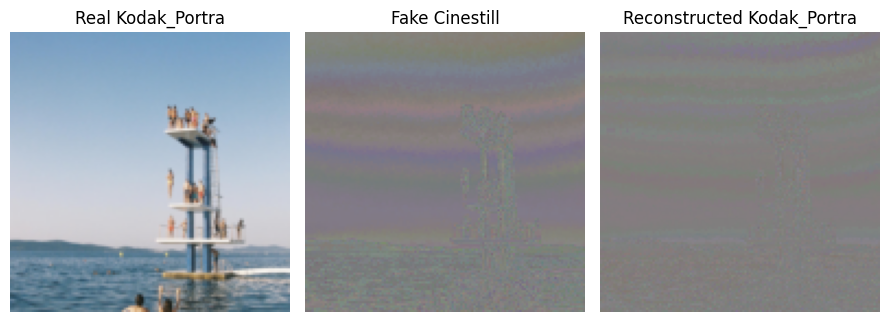

  2%|█▉                                                                            | 50/2000 [02:22<1:32:12,  2.84s/it]

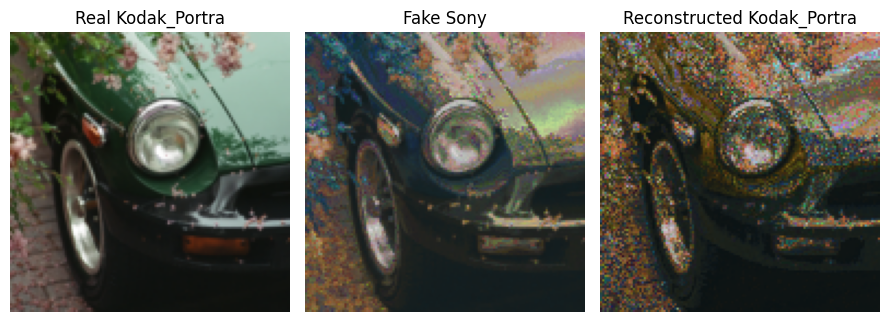

  5%|███▊                                                                         | 100/2000 [04:46<1:21:12,  2.56s/it]

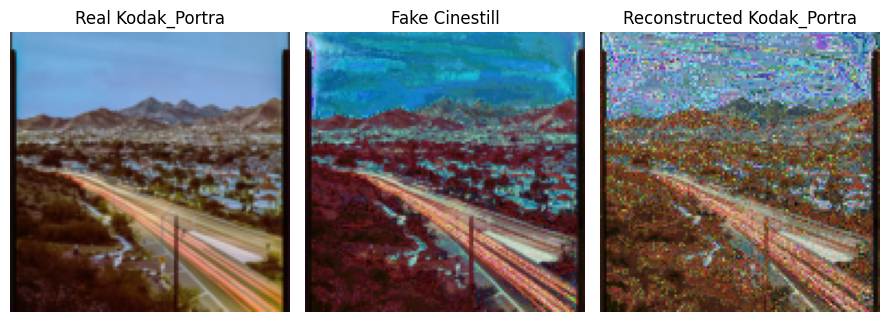

  8%|█████▊                                                                       | 150/2000 [07:11<1:30:21,  2.93s/it]

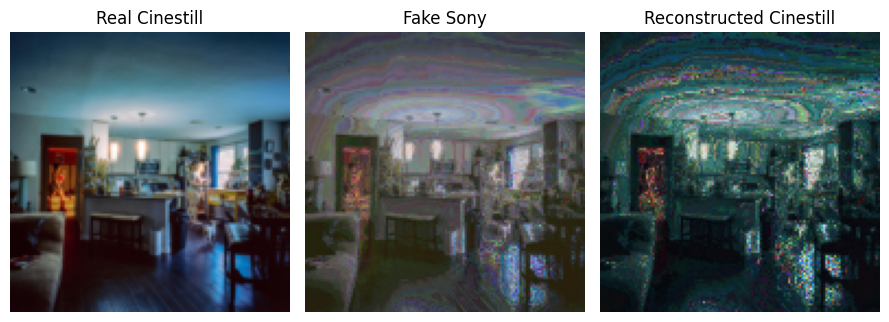

 10%|███████▋                                                                     | 200/2000 [09:41<1:35:14,  3.17s/it]

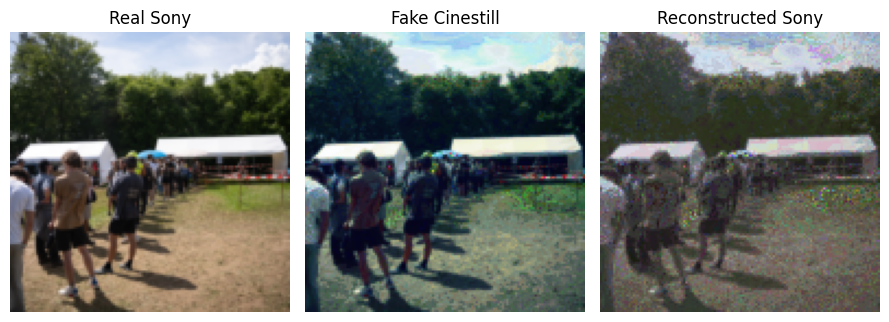

 12%|█████████▋                                                                   | 250/2000 [12:07<1:25:24,  2.93s/it]

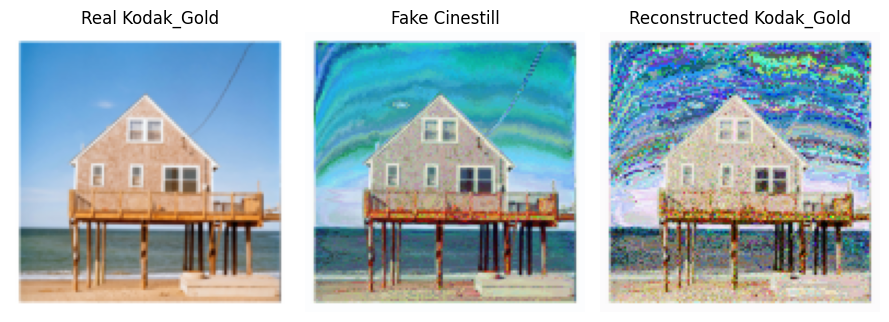

 15%|███████████▌                                                                 | 300/2000 [14:33<1:22:16,  2.90s/it]

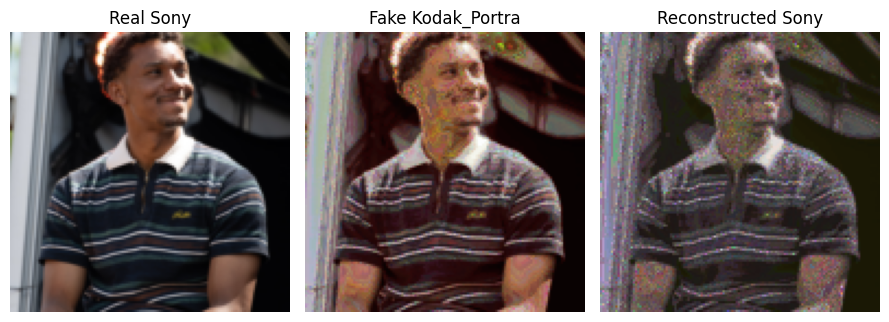

 18%|█████████████▍                                                               | 350/2000 [16:58<1:16:10,  2.77s/it]

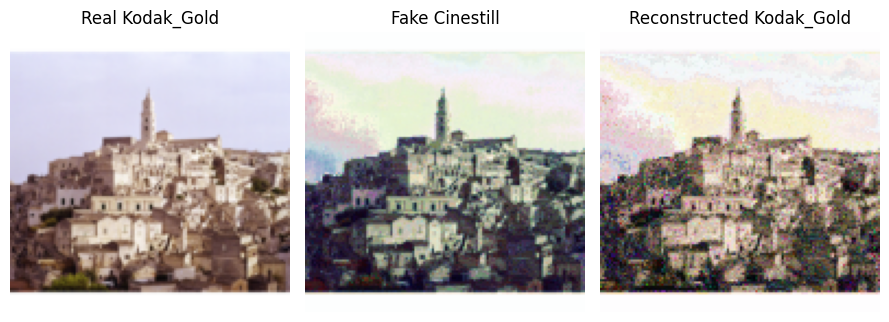

 20%|███████████████▍                                                             | 400/2000 [19:18<1:14:37,  2.80s/it]

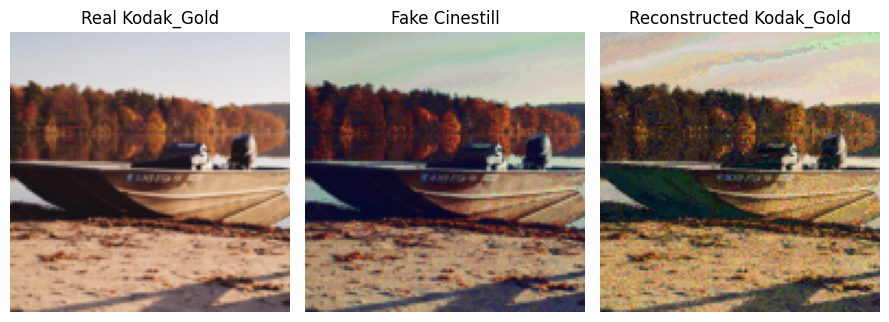

 22%|█████████████████▎                                                           | 450/2000 [21:34<1:07:27,  2.61s/it]

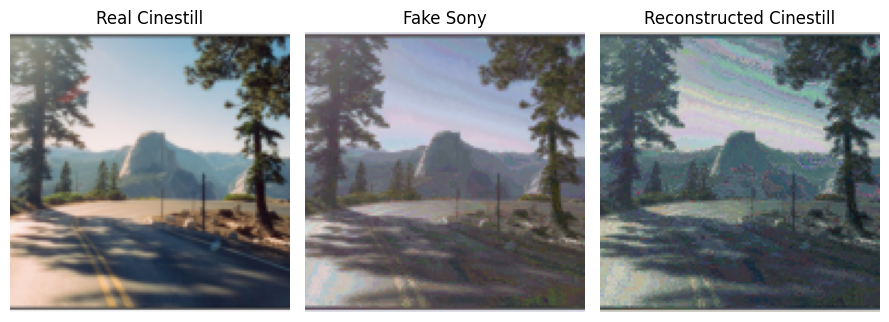

 25%|███████████████████▎                                                         | 500/2000 [23:54<1:08:17,  2.73s/it]

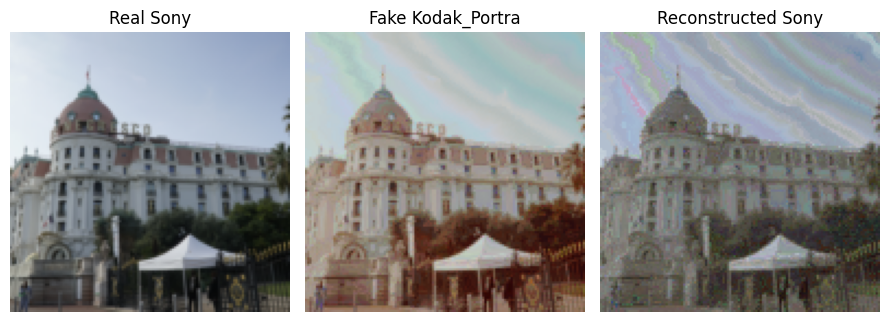

 28%|█████████████████████▏                                                       | 550/2000 [26:11<1:06:07,  2.74s/it]

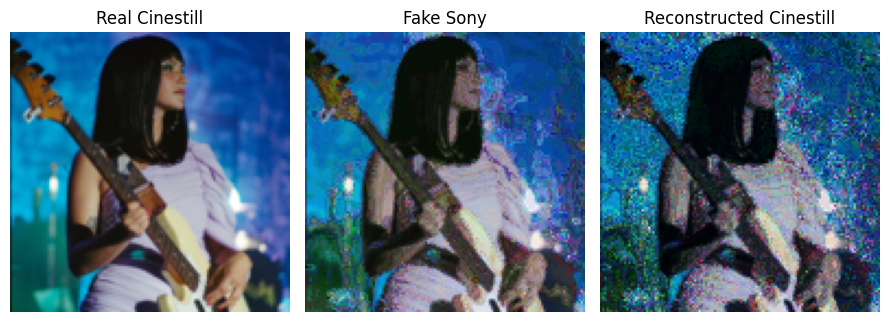

 30%|███████████████████████                                                      | 600/2000 [28:30<1:04:29,  2.76s/it]

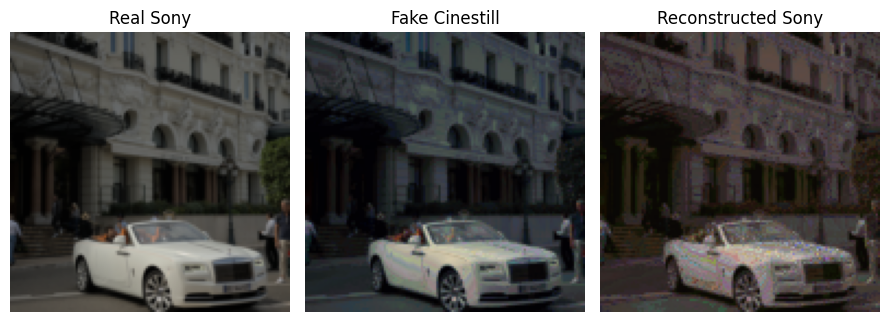

 32%|█████████████████████████▋                                                     | 650/2000 [29:54<31:26,  1.40s/it]

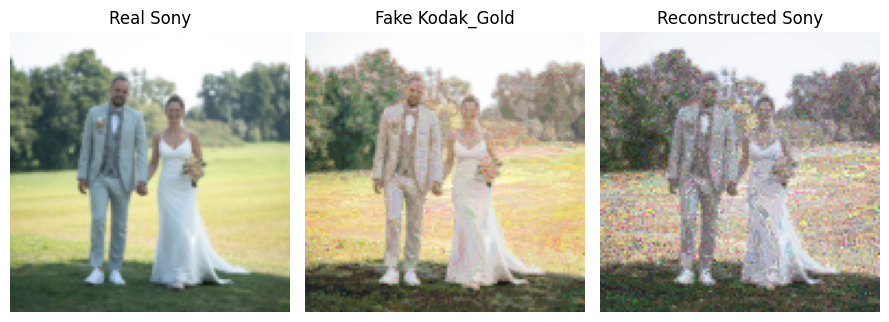

 35%|███████████████████████████▋                                                   | 700/2000 [31:04<29:18,  1.35s/it]

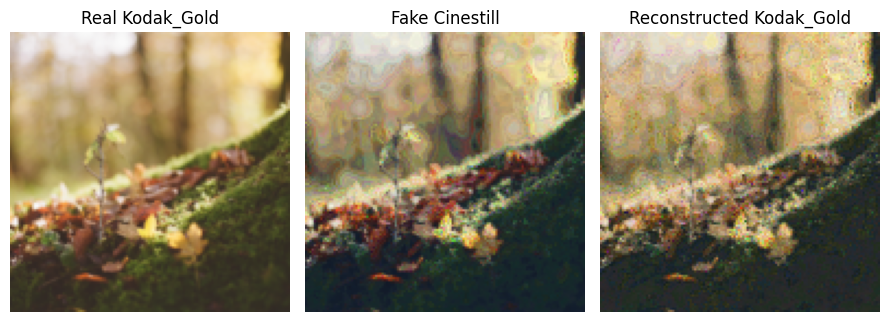

 38%|█████████████████████████████▋                                                 | 750/2000 [32:15<28:35,  1.37s/it]

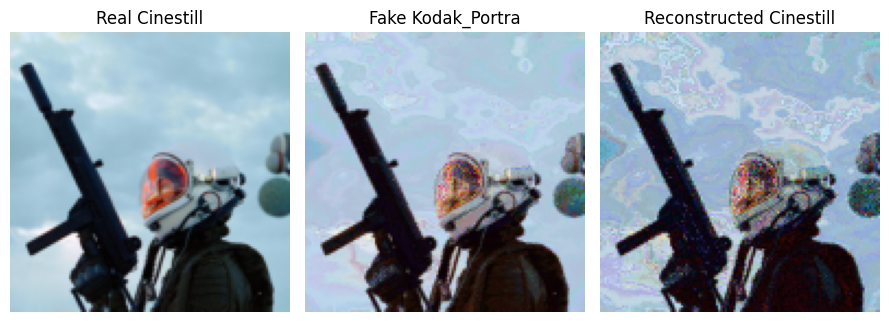

 40%|███████████████████████████████▌                                               | 800/2000 [33:25<27:40,  1.38s/it]

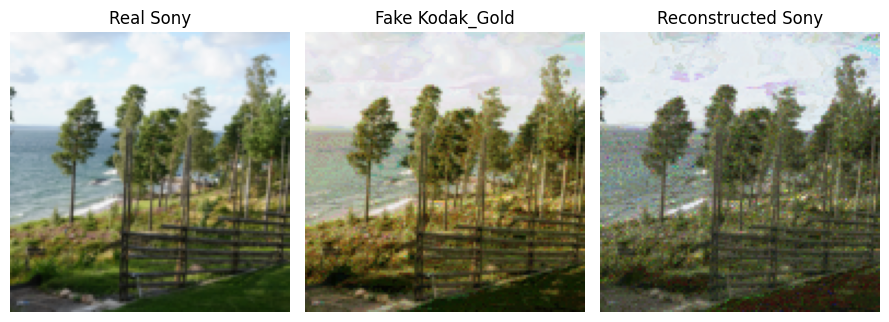

 42%|█████████████████████████████████▌                                             | 850/2000 [34:37<27:03,  1.41s/it]

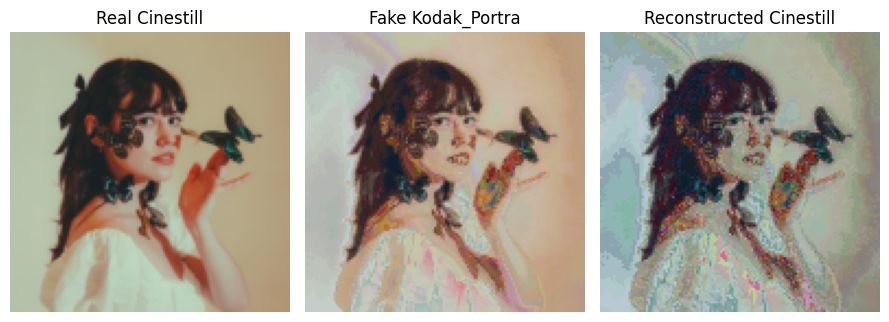

 45%|███████████████████████████████████▌                                           | 900/2000 [35:48<25:24,  1.39s/it]

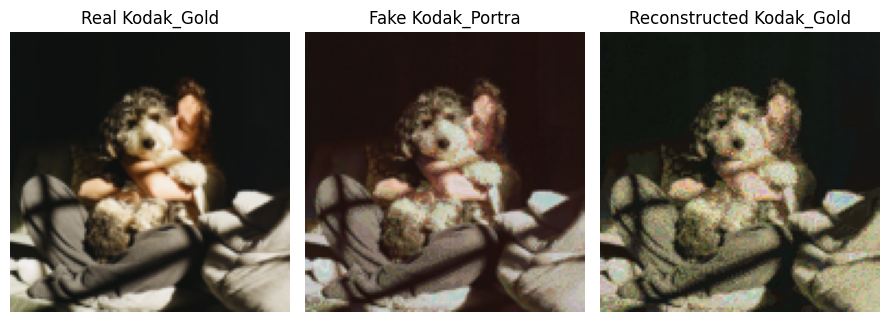

 48%|█████████████████████████████████████▌                                         | 950/2000 [36:59<24:27,  1.40s/it]

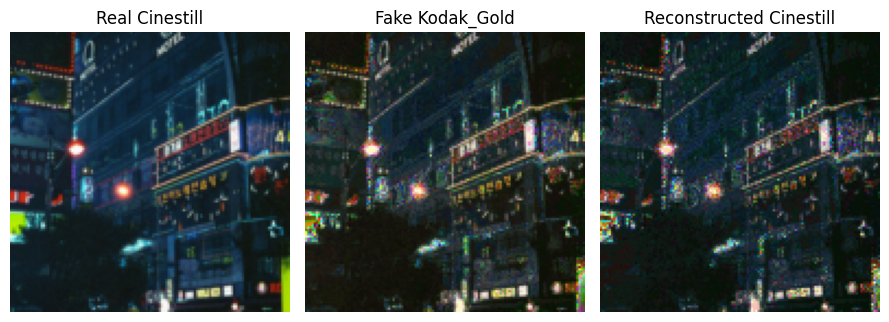

 50%|███████████████████████████████████████                                       | 1000/2000 [38:12<23:26,  1.41s/it]

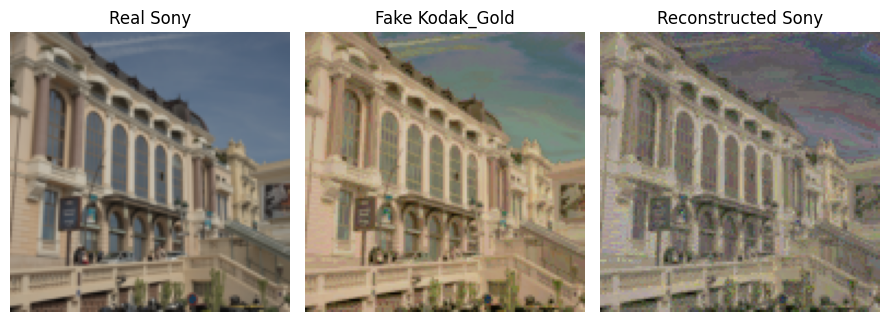

 52%|████████████████████████████████████████▉                                     | 1050/2000 [39:24<24:30,  1.55s/it]

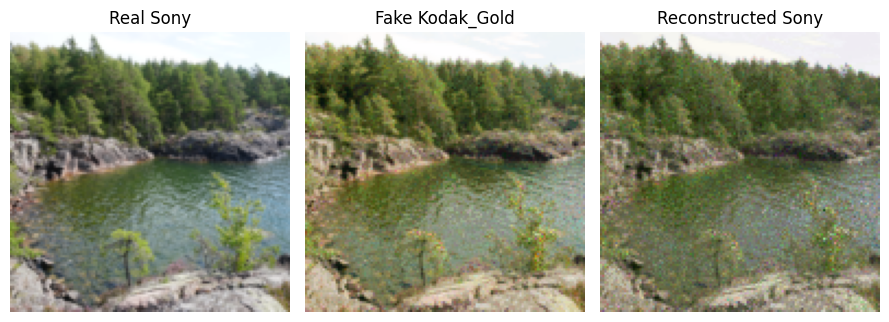

 55%|██████████████████████████████████████████▉                                   | 1100/2000 [40:38<20:43,  1.38s/it]

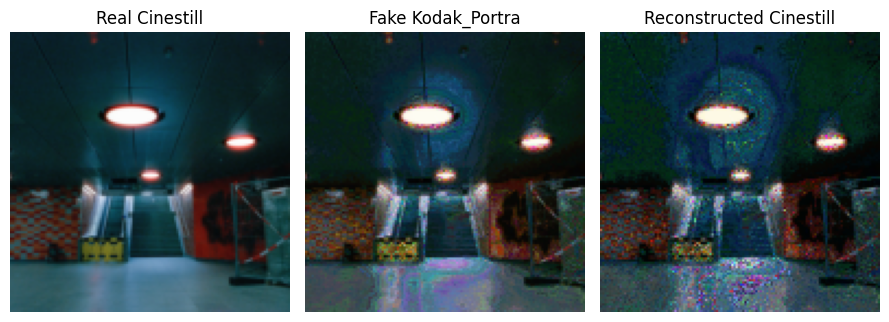

 57%|████████████████████████████████████████████▊                                 | 1150/2000 [41:54<20:46,  1.47s/it]

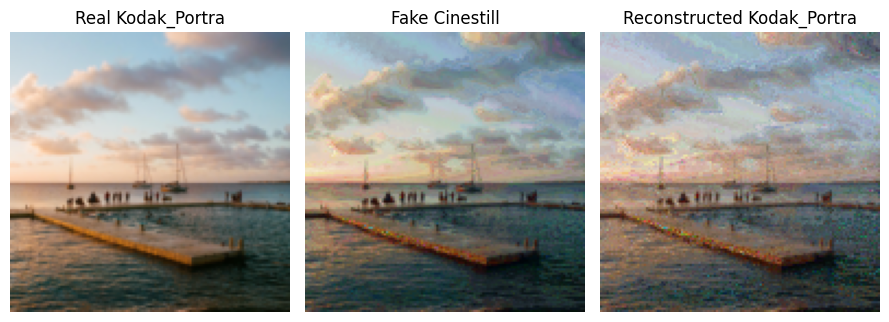

 60%|██████████████████████████████████████████████▊                               | 1200/2000 [43:10<20:21,  1.53s/it]

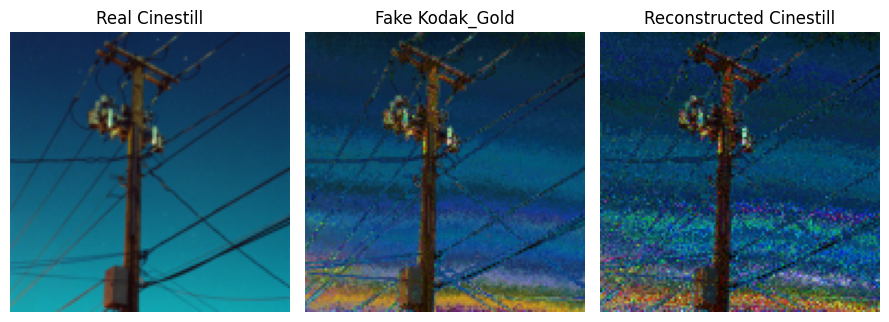

 62%|████████████████████████████████████████████████▊                             | 1250/2000 [44:26<19:12,  1.54s/it]

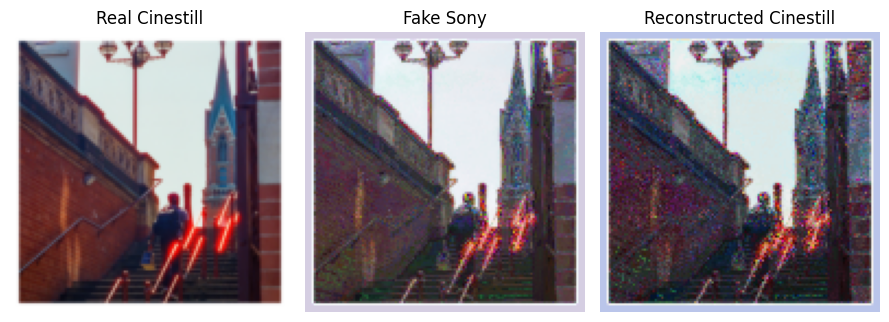

 65%|██████████████████████████████████████████████████▋                           | 1300/2000 [45:42<17:41,  1.52s/it]

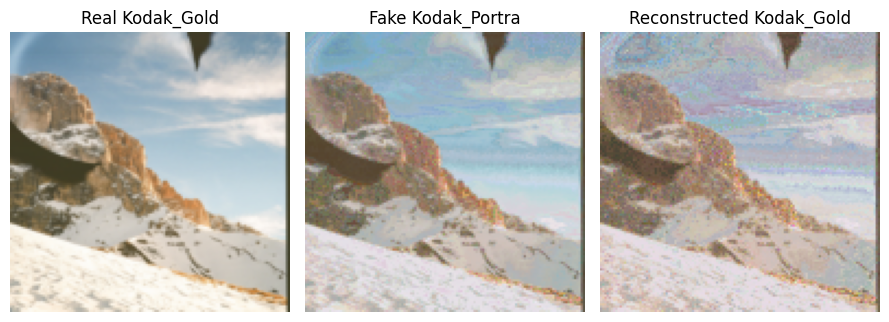

 68%|████████████████████████████████████████████████████▋                         | 1350/2000 [46:58<16:24,  1.51s/it]

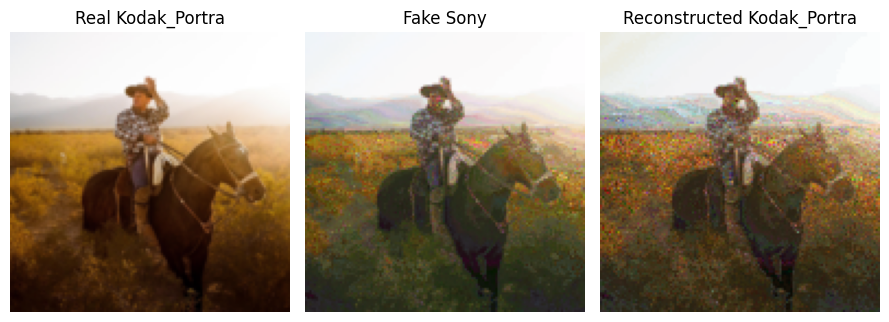

 70%|██████████████████████████████████████████████████████▌                       | 1400/2000 [48:14<15:29,  1.55s/it]

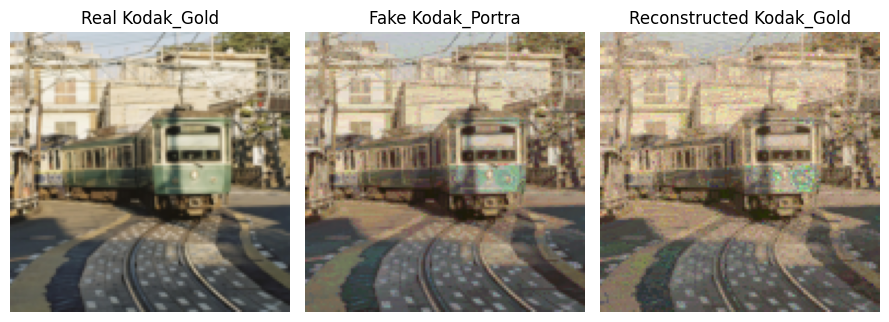

 72%|████████████████████████████████████████████████████████▌                     | 1450/2000 [49:31<13:53,  1.52s/it]

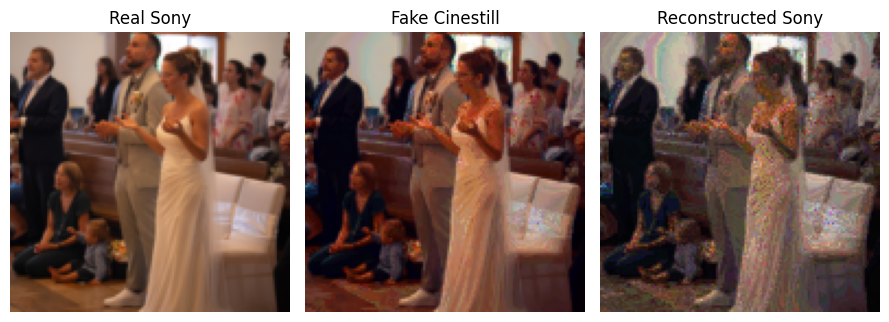

 75%|██████████████████████████████████████████████████████████▌                   | 1500/2000 [50:48<12:57,  1.55s/it]

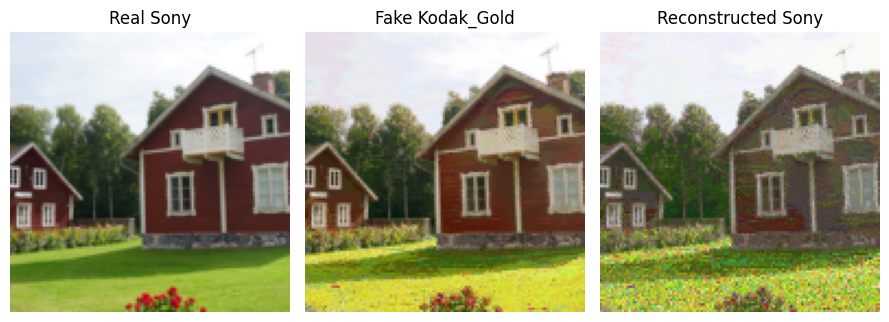

 78%|████████████████████████████████████████████████████████████▍                 | 1550/2000 [52:01<11:00,  1.47s/it]

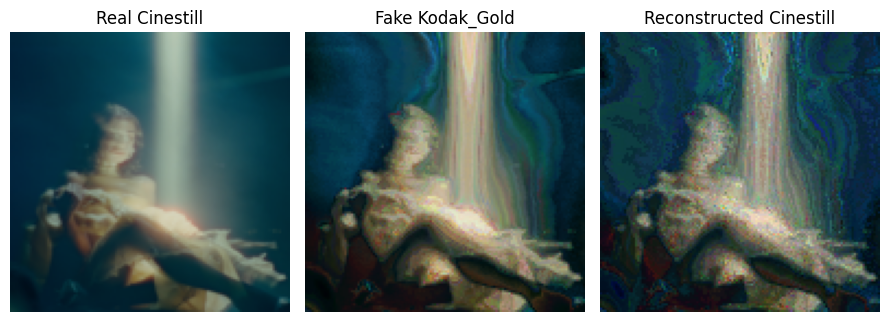

 80%|██████████████████████████████████████████████████████████████▍               | 1600/2000 [53:09<08:57,  1.34s/it]

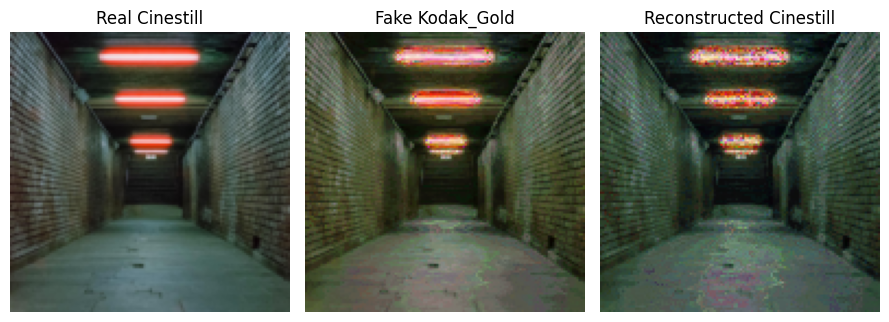

 82%|████████████████████████████████████████████████████████████████▎             | 1650/2000 [54:17<07:53,  1.35s/it]

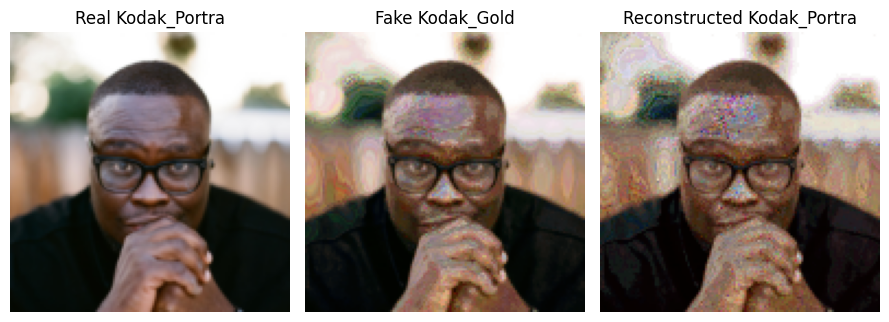

 85%|██████████████████████████████████████████████████████████████████▎           | 1700/2000 [55:25<06:42,  1.34s/it]

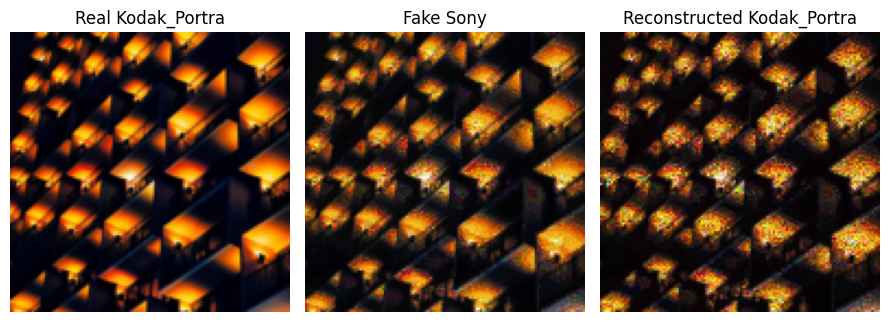

 88%|████████████████████████████████████████████████████████████████████▎         | 1750/2000 [56:32<05:37,  1.35s/it]

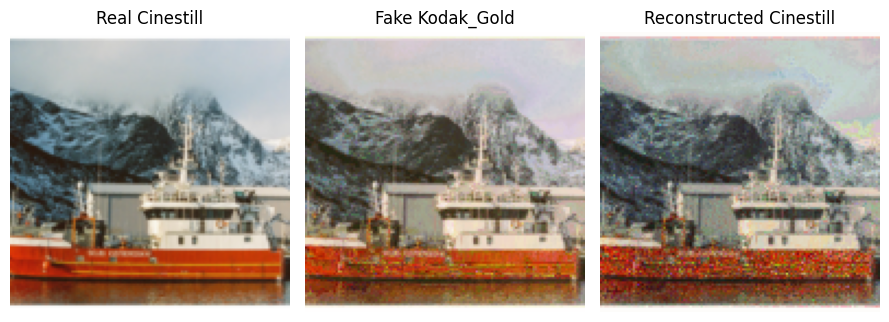

 90%|██████████████████████████████████████████████████████████████████████▏       | 1800/2000 [57:40<04:30,  1.35s/it]

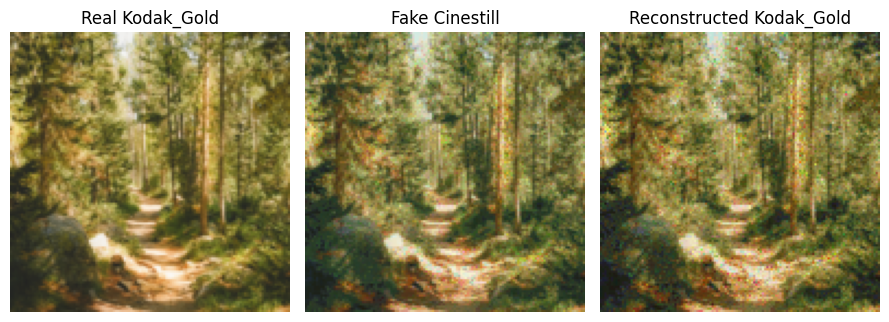

 92%|████████████████████████████████████████████████████████████████████████▏     | 1850/2000 [58:48<03:23,  1.36s/it]

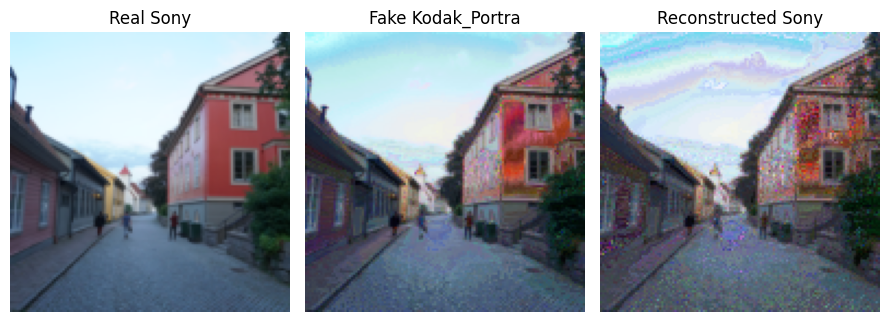

 95%|██████████████████████████████████████████████████████████████████████████    | 1900/2000 [59:56<02:14,  1.35s/it]

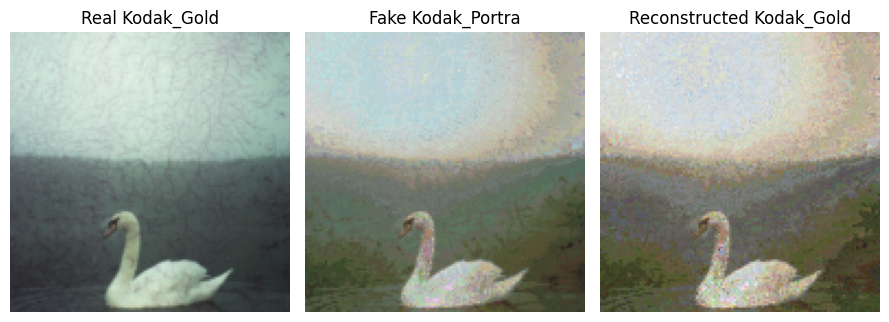

 98%|██████████████████████████████████████████████████████████████████████████  | 1950/2000 [1:01:04<01:08,  1.37s/it]

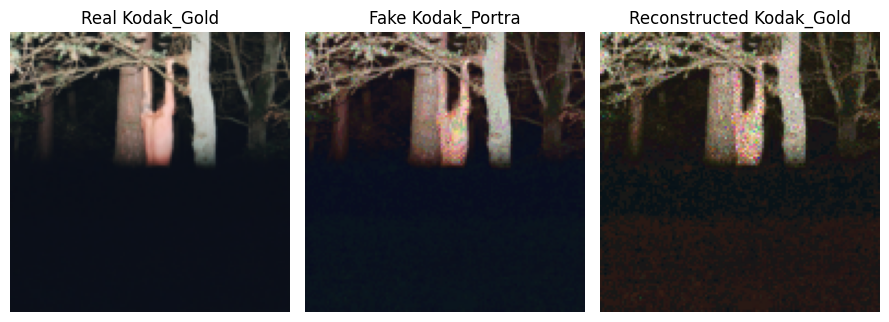

100%|████████████████████████████████████████████████████████████████████████████| 2000/2000 [1:02:12<00:00,  1.87s/it]


In [31]:
G_Losses, D_Losses = train_stargan(netD, netG, dataloader, opt_disc, opt_gen, L1, mse, ce, d_scaler, g_scaler, num_epochs, 4, lambda_cycle, lambda_identity)

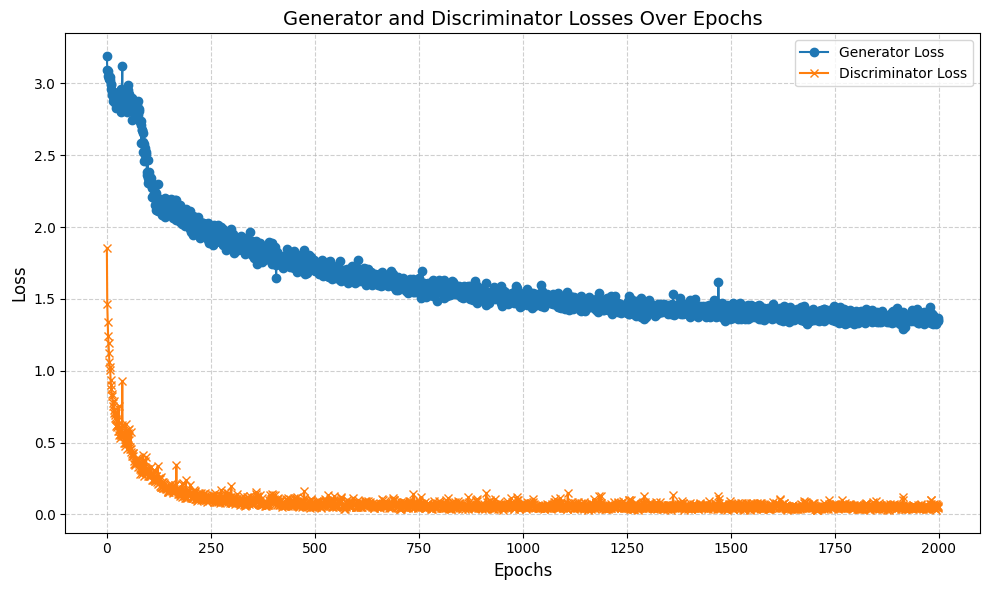

In [32]:
plt.figure(figsize=(10, 6))

plt.plot(G_Losses, label="Generator Loss", marker='o')

plt.plot(D_Losses, label="Discriminator Loss", marker='x')

plt.title("Generator and Discriminator Losses Over Epochs", fontsize=14)

plt.xlabel("Epochs", fontsize=12)

plt.ylabel("Loss", fontsize=12)

plt.legend(fontsize=10)

plt.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()

plt.show()

As we can see above the loss development over the training epochs looks a lot more stable than with the previous CycleGAN approach. Both losses decrease rapidly in the first 200 episodes and appear to converge towards the end of training. We will evaluate our model in the following part of the notebook to see if training was as successfull as it appears to have been at this point.

## Save model for evaluation

In [33]:
def save_checkpoint(model, optimizer, directory, filename="models/checkpoint.pth.tar"):
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    directory = f"models/{directory}"
    # Create the directory if it doesn't exist
    if not os.path.exists(directory):
        os.makedirs(directory)
        
    torch.save(checkpoint, os.path.join(directory, filename))

In [34]:
save_checkpoint(netG, opt_gen, directory=experiment, filename=f"{experiment}.pth.tar")

=> Saving checkpoint


# Evaluation

In [35]:
def load_checkpoint(model, optimizer, experiment, filepath):
    print("=> Loading checkpoint")
    filepath = f"models/{experiment}/{filepath}"
    checkpoint = torch.load(filepath, weights_only=True)
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])
    return model, optimizer

In [292]:
evalgen = LUTGenerator(lut_size=33, label_dim=4).to(device)
opt_evalgen = optim.Adam(evalgen.parameters(),
    lr=learning_rate,
    betas=(0.5, 0.999),
)
eval_experiment = "stargan_v9_128"
eval_netG, _ = load_checkpoint(evalgen, opt_evalgen, eval_experiment, f"{eval_experiment}.pth.tar")

=> Loading checkpoint


In [293]:
class ValDataset(Dataset):
    def __init__(self, val_images, transform=None):
        self.val_images = val_images
        self.transform = transform

    def __len__(self):
        return len(self.val_images)

    def __getitem__(self, idx):
        val_image = self.val_images[idx]
        if self.transform:
            val_image = self.transform(val_image)
        return val_image

In [294]:
transform1024 = transforms.Compose([
    transforms.Resize(1024),
    transforms.CenterCrop((1024, 1024)),
    transforms.ToTensor(), 
    #transforms.RandomRotation(degrees=15),
    #transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),

    #transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

In [295]:
def load_images_from_directory_high_res(directory_path, num_images=100, offset=0):
    images = []
    files = os.listdir(directory_path)
    # Ensure only images are processed
    image_files = [f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    for i, image_file in enumerate(image_files[offset:offset+num_images]):
        image_path = os.path.join(directory_path, image_file)
        img = Image.open(image_path).convert('RGB')  # Convert to RGB in case of grayscale
        img = transform1024(img)  # Apply the transformations
        images.append(img)
        
    images_tensor = torch.stack(images)
    images_tensor = images_tensor.permute(0, 2, 3, 1)
    return images_tensor

In [419]:
eval_images = load_images_from_directory('../../sony_images/wedding/random', num_images=64, offset=160)
eval_images_high_res = load_images_from_directory_high_res('../../sony_images/wedding/random', num_images=64, offset=160)
eval_images_np = eval_images.numpy()
eval_dataset = ValDataset(eval_images_np, transform)
eval_dataloader = DataLoader(eval_dataset, batch_size=64, shuffle=False)

In [420]:
label1 = [1,0,0,0]
label_tensor = torch.tensor(label1, dtype=torch.float32).repeat(64, 1).to(device)

In [421]:
#graded = kodak ektar = B
#ungraded = kodak gold = A

ev_images = next(iter(eval_dataloader))
ev_images = ev_images.to(device)

netG.eval()

# Test of image transfer in kodak portra
fake_images_d1, d1_luts = eval_netG(ev_images, label_tensor)

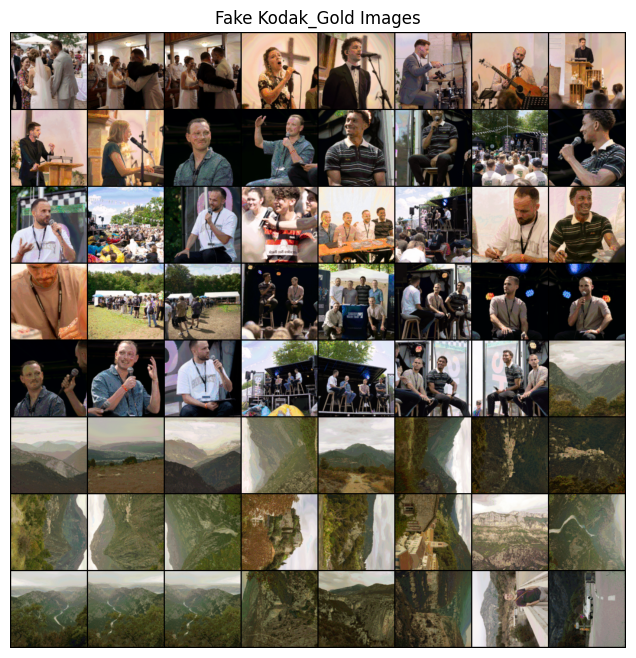

In [422]:
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Fake {name_d1} Images")
plt.imshow(np.transpose(vutils.make_grid(fake_images_d1.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [423]:
label2 = [0,1,0,0]
label_tensor = torch.tensor(label2, dtype=torch.float32).repeat(64, 1).to(device)

In [424]:
fake_images_d2, d2_luts = eval_netG(ev_images, label_tensor)

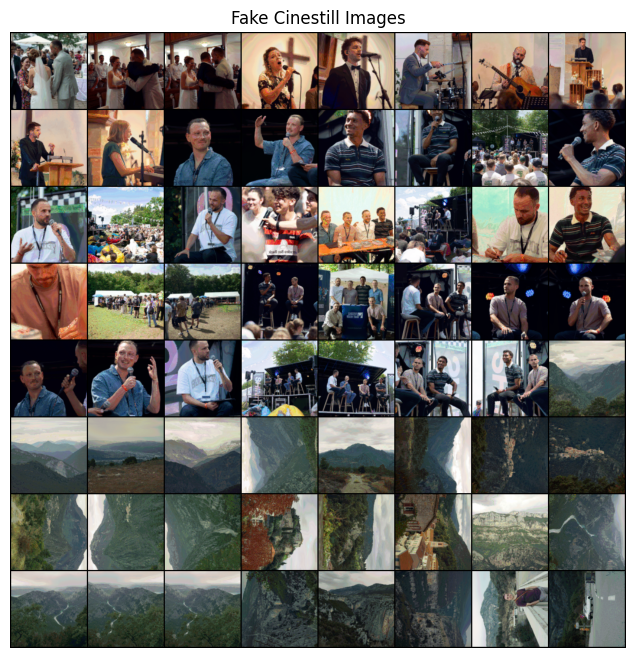

In [425]:
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Fake {name_d2} Images")
plt.imshow(np.transpose(vutils.make_grid(fake_images_d2.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [426]:
label4 = [0,0,0,1]
label_tensor = torch.tensor(label4, dtype=torch.float32).repeat(64, 1).to(device)

In [427]:
fake_images_d4, d4_luts = eval_netG(ev_images, label_tensor)

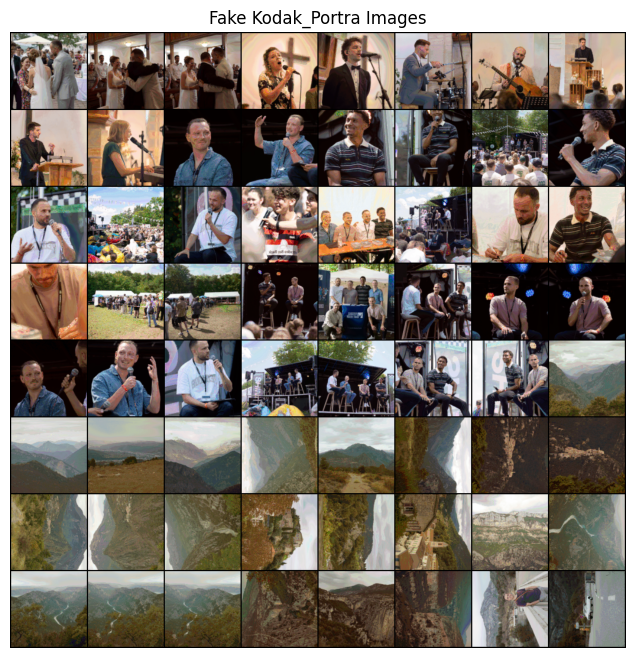

In [428]:
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Fake {name_d4} Images")
plt.imshow(np.transpose(vutils.make_grid(fake_images_d4.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [429]:
def trilinear_interpolation(luts, images):
    # Scale images to be between -1 and 1
    img = (images - 0.5) * 2.0  # Shape: [4, 3, 256, 256]

    # Add a singleton dimension to represent "channel" for LUT interpolation
    img = img.permute(0, 2, 3, 1).unsqueeze(1)  # Shape: [4, 1, 256, 256, 3]

    # Ensure LUT is in the correct format
    LUT = luts.permute(0, 4, 1, 2, 3)  # Shape: [4, 3, 8, 8, 8]

    # Perform grid sampling for each channel
    result = F.grid_sample(LUT, img, mode='bilinear', padding_mode='border', align_corners=True)  # [4, 3, 1, 256, 256]

    # Remove the singleton dimension and permute to the correct format
    result = result.squeeze(2)  # Remove the extra "depth" dimension - Shape: [4, 3, 256, 256]

    return result

In [430]:
eval_images_np_hr = eval_images_high_res.numpy()
eval_dataset_hr = ValDataset(eval_images_np_hr, transform)
eval_dataloader_hr = DataLoader(eval_dataset_hr, batch_size=64, shuffle=False)

ev_images_hr = next(iter(eval_dataloader_hr))
ev_images_hr = ev_images_hr.to(device)

fake_images_d1_hr = trilinear_interpolation(d1_luts, ev_images_hr)
fake_images_d2_hr = trilinear_interpolation(d2_luts, ev_images_hr)
fake_images_d4_hr = trilinear_interpolation(d4_luts, ev_images_hr)

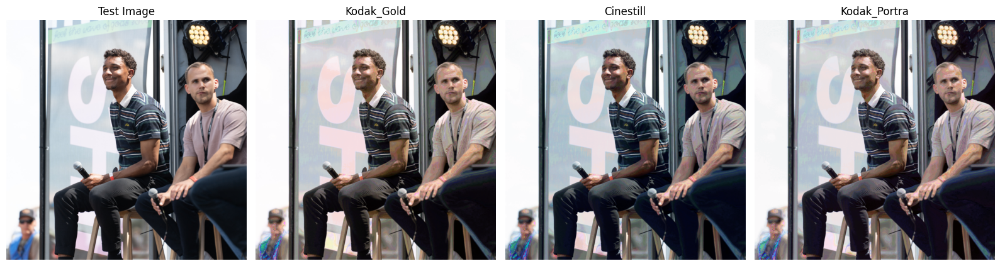

In [480]:
image_index = 38
display_images([ev_images_hr[image_index], fake_images_d1_hr[image_index], fake_images_d2_hr[image_index], fake_images_d4_hr[image_index]], ["Test Image", name_d1, name_d2, name_d4], fig_x=16, fig_y=7)

As we expected, the Kodak Gold and Portra images have warmer tones and the Cinestill 800T image has cooler tones than the original image. Another positive thing to note is that our model shows only minor artifacts and broken color transitions and performs much better than the previous CycleGAN.